## Network Simplification & Road Building

This notebook applies the developed methodology to two case studies:
1. Dublin, Ireland
2. Hamburg, Germany
3. Bristol, United Kingdom

### Dependencies

In [1]:
import sys
import os
sys.path.append(os.path.abspath('../src/'))
from process_roads import *

## plotting libraries
import matplotlib.pyplot as plt
import matplotlib.cm as cm
plt.style.use('ggplot')
import folium
import contextily as ctx
import matplotlib
from shapely.geometry import box

## Dublin, Ireland

In [ ]:
crs_latlon = 'EPSG:4326'
crs_metric = 'EPSG:2157'

In [8]:
# --------------------------------------------------------
#                        Load data 
# --------------------------------------------------------

# get city road network as gdf
place_name = 'Dublin, Ireland'
edges = load_roads_from_placename(place_name = place_name,  network_type='drive', simplify=True)
# check datatypes
correct_datatypes(edges, ['osmid', 'oneway', 'lanes', 'name', 'highway', 'maxspeed', 'tunnel', 'bridge', 'width', 'junction', 'est_width'])
# process attributes for meaningful aggregation
process_list_values(edges)


# --------------------------------------------------------
#                   Process Roundabouts
# --------------------------------------------------------

# extract roundabout segments
identified_junctions, edges = extract_roundabouts(edges)
# get junctions building geometries and compose the roundabouts
roundabout_gdf = continous_roundabout(identified_junctions)
# augment roundabout with other information from OSM (e.g., name, maxspeed, etc.) linked to the identified junction segments
# and augment overall edges dataset
edges = augment_roundabouts(roundabout_gdf, identified_junctions, edges)


# --------------------------------------------------------
#           Build Continuous Road Representations
# --------------------------------------------------------

process_road_names(edges)
final_edges = merge_segments(edges, crs_metric = 'EPSG:2157', crs_latlon = 'EPSG:4326', verbose = True)

Unique sets: 279
Total occurrences: 526
 ----------- RESULT PROCESSING LIST NAMES: ----------- 
Reduced from 279 to 263 geometries.
 ----------- RESULT PROCESSING STRING NAMES: ----------- 
Original number of segments (with unique name - as string): 24409
Final number of MultiLineStrings (geometries blocks) obtained: 3790
Reduction in number of geometries after recursion: from 4053 to 3639
Overall reduction: from 26454 in the original dataset, to 3639.


In [9]:
## number missing value per column
final_edges.isna().sum()

geometry               0
osmid                  0
min_lanes            557
max_lanes            557
min_maxspeed          34
max_maxspeed          34
oneway                 0
name                   0
highway              204
tunnel                 0
bridge                 0
standardized_name      0
ID_geom              139
length                 0
dtype: int64

In [10]:
## percentage missing value per column
final_edges.isna().mean() * 100

geometry              0.000000
osmid                 0.000000
min_lanes            15.306403
max_lanes            15.306403
min_maxspeed          0.934323
max_maxspeed          0.934323
oneway                0.000000
name                  0.000000
highway               5.605936
tunnel                0.000000
bridge                0.000000
standardized_name     0.000000
ID_geom               3.819731
length                0.000000
dtype: float64

### Check absence of overlaps & duplicated geometries

In [4]:
# this function returns geometries that are overlapping or duplicated;
# since we do not want segments to be assigned to multiple roads, we aim at having no overlaps,
# thus this function should return an empty list
find_duplicate_or_overlapping_segments(final_edges) 

[]

### Road lengths

In [11]:
final_edges['length'].describe() # in meters

count     3639.000000
mean       351.670358
std        547.673870
min          4.098490
25%        103.090231
50%        190.522277
75%        390.690927
max      13456.316290
Name: length, dtype: float64

In [12]:
final_edges[final_edges['length'] <= final_edges['length'].mean() + 2*final_edges['length'].std()]['length'].describe()

count    3516.000000
mean      277.570122
std       261.503038
min         4.098490
25%       100.681987
50%       181.515237
75%       355.298908
max      1445.148134
Name: length, dtype: float64

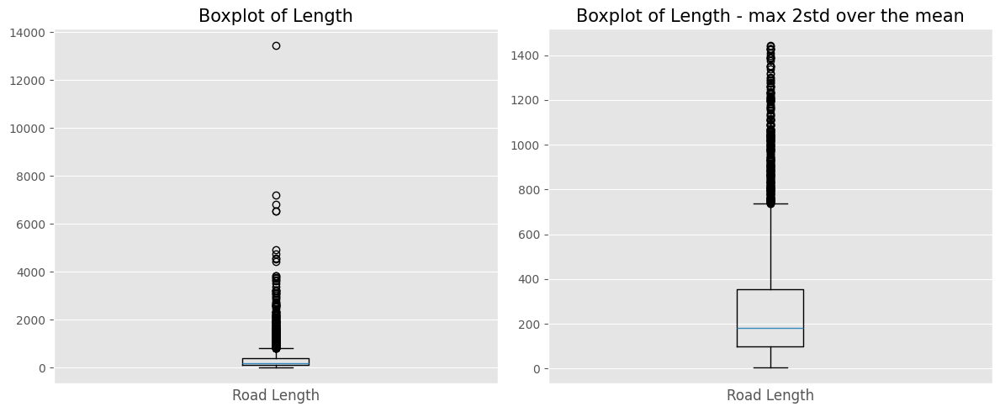

In [13]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

ax1.boxplot(final_edges['length'], vert=True)
ax1.set_title('Boxplot of Length', size=15)
ax1.set_xlabel('Road Length')
ax1.set_xticks([])
ax1.set_xticklabels([])

ax2.boxplot(final_edges[final_edges['length'] <= final_edges['length'].mean() + 2*final_edges['length'].std()]['length'], vert=True)
ax2.set_title('Boxplot of Length - max 2std over the mean', size=15)
ax2.set_xlabel('Road Length')
ax2.set_xticks([])
ax2.set_xticklabels([])

plt.tight_layout()
plt.show()

In [14]:
Q1 = final_edges['length'].quantile(0.25)
Q3 = final_edges['length'].quantile(0.75)
IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

outliers = final_edges[(final_edges['length'] < lower_bound) | (final_edges['length'] > upper_bound)]
outliers = gpd.GeoDataFrame(outliers, geometry='geometry', crs=crs_latlon)
print(f"Number of outliers: {len(outliers)} ({round(len(outliers)*100/len(final_edges), 2)}%)")

Number of outliers: 318 (8.74%)


In [15]:
# stats of outliers
outliers['length'].describe()

count      318.000000
mean      1604.432994
std       1171.756006
min        827.760389
25%        993.301484
50%       1227.961993
75%       1718.819218
max      13456.316290
Name: length, dtype: float64

In [16]:
print(f"Only {round(len(outliers[outliers['length']>2000]) * 100 / len(final_edges), 2)}% ({len(outliers[outliers['length']>2000])}) of the total numer of road-blocks is longer than 2km.\nThis includes mostly roads with multiple lanes (bigger roads), as each lane length is count separately in the length computation.")

# outliers[outliers['length']>2000].plot(); # blocks longer than 2km (NOTE: WHEN COMPUTING LENGTHS, SEPARATE LANES LENGTHS ARE SUMMED TOGETHER EVEN IF SAME ROAD)

Only 1.62% (59) of the total numer of road-blocks is longer than 2km.
This includes mostly roads with multiple lanes (bigger roads), as each lane length is count separately in the length computation.


### Example of Road Representation: 
#### Airport Motorway

In [17]:
original_airport_motorway = edges[edges['standardized_name'].apply(lambda x: x == sorted(['airport motorway', 'dublin tunnel'])) |
                                        edges['standardized_name'].isin(['airport motorway', 'dublin tunnel']) ]

final_airport_motorway = final_edges[final_edges['standardized_name'].apply(lambda x: x == sorted(['airport motorway', 'dublin tunnel'])) |
                                        final_edges['standardized_name'].isin(['airport motorway', 'dublin tunnel']) ]

In [18]:
def plot_road(full_df, single_road_df, title = ''):
    colors = cm.viridis(np.linspace(0, 1, len(single_road_df)))

    ax = full_df.plot(color='lightgrey', figsize=(10, 8), edgecolor='black')

    for i, segment in enumerate(single_road_df.index):
        single_road_df.loc[segment:segment].plot(ax=ax, color=[colors[i]], edgecolor='black')

    ax.set_title(title)
    plt.show()

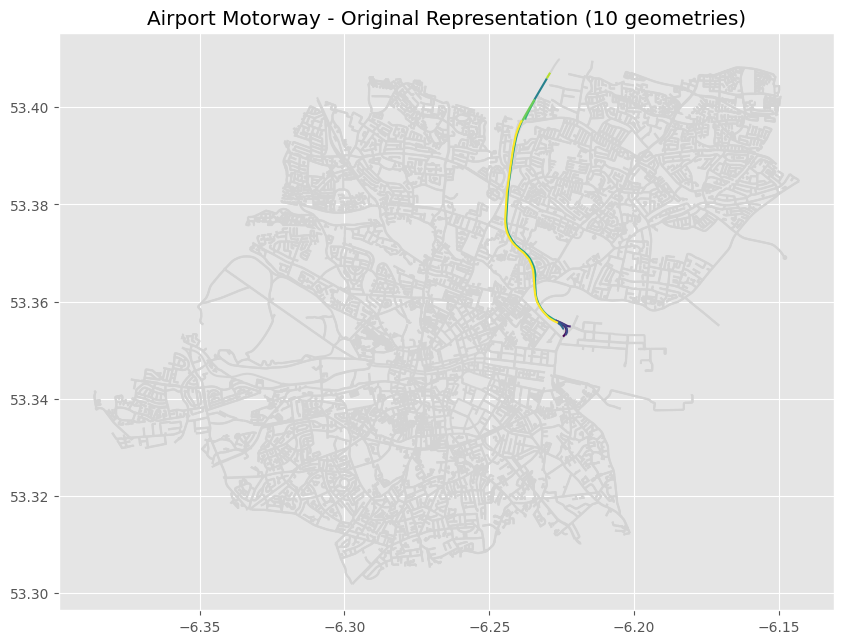

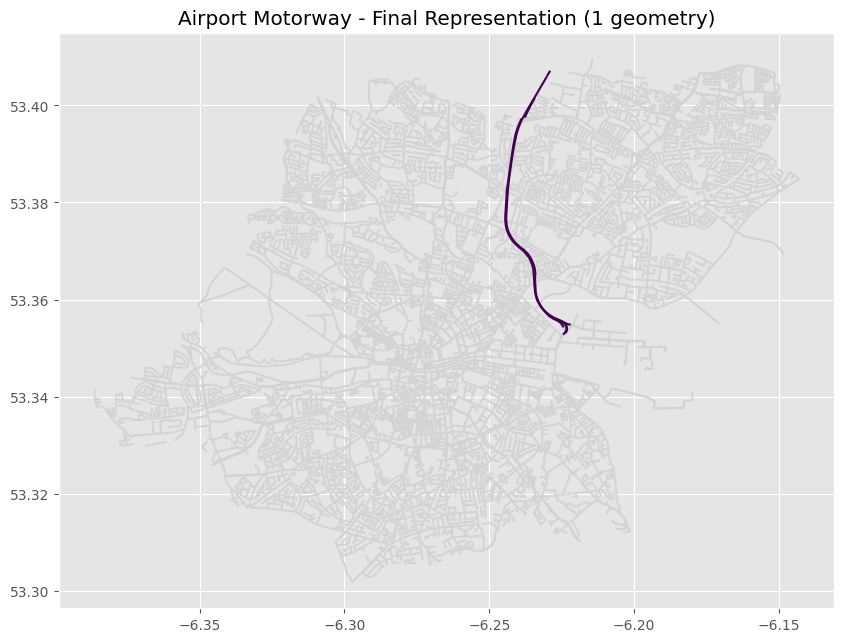

In [19]:
plot_road(edges, original_airport_motorway,
          title=f'Airport Motorway - Original Representation ({len(original_airport_motorway)} geometries)')

plot_road(final_edges, final_airport_motorway,
          title=f'Airport Motorway - Final Representation ({len(final_airport_motorway)} geometry)')

### Other examples

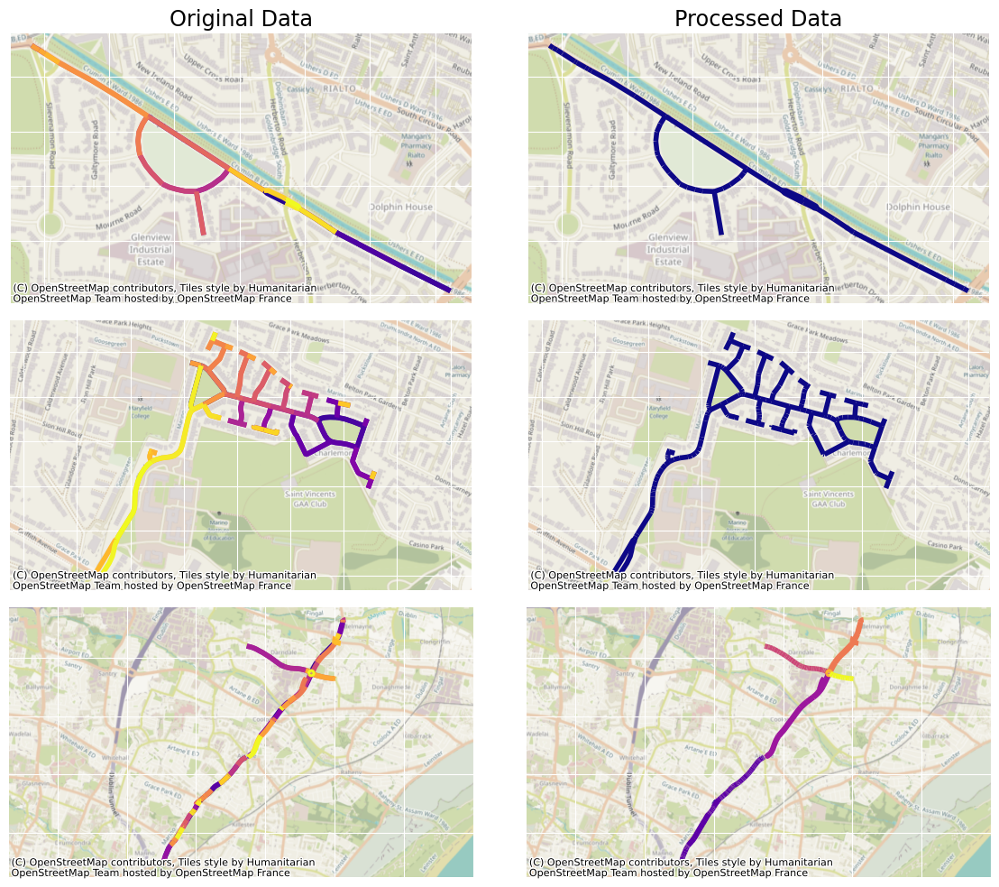

In [20]:
roads_for_viz = [ ['Dolphin Road'],
                ['Charlemont'],
                ['Beresford Place'],
                ['Annesley Bridge Road'],
                ['Darndale Roundabout', 'Malahide Road', 'Blunden Drive', 'Priorswood Road']
                ]


# compute common extent to use for each map in the viz (bounding box)
all_geometries = final_edges[final_edges.name.isin(sum(roads_for_viz, []))].geometry
common_bounds = all_geometries.total_bounds  # [minx, miny, maxx, maxy]


## plot
matplotlib.rcParams['font.size'] = 12.0

fig, axs = plt.subplots(3, 2, figsize=(12, 10))


### FIRST ROW
i = 0
ORIGINAL_VERSION = edges[edges.name.isin(roads_for_viz[i])]
PROCESSED_VERSION = final_edges[final_edges.name.isin(roads_for_viz[i])]

## ORIGINAL PLOT
ORIGINAL_VERSION.plot(cmap='plasma', linewidth=4, ax=axs[0, 0], legend=False)
ctx.add_basemap(axs[0, 0], crs=crs_latlon)
axs[0, 0].set_title("Original Data")
axs[0, 0].tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)  # remove ticks

## PROCESSED PLOT
PROCESSED_VERSION.plot(cmap='plasma', linewidth=4, ax=axs[0, 1], legend=False)
ctx.add_basemap(axs[0, 1], crs=crs_latlon)
axs[0, 1].set_title("Processed Data")
axs[0, 1].tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)

## remove plots border
for spine in axs[0, 0].spines.values():
    spine.set_visible(False)
for spine in axs[0, 1].spines.values():
    spine.set_visible(False)




### SECOND ROW
i = 1
ORIGINAL_VERSION = edges[edges.name.isin(roads_for_viz[i])]
PROCESSED_VERSION = final_edges[final_edges.name.isin(roads_for_viz[i])]

## ORIGINAL PLOT
ORIGINAL_VERSION.plot(cmap='plasma', linewidth=4, ax=axs[1, 0], legend=False)
axs[1, 0].set_xlim(-6.236 - 0.0045, -6.228 + 0.0048)
ctx.add_basemap(axs[1, 0], crs=crs_latlon)
axs[1, 0].tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)  # remove ticks

## PROCESSED PLOT
PROCESSED_VERSION.plot(cmap='plasma', linewidth=4, ax=axs[1, 1], legend=False)
axs[1, 1].set_xlim(-6.236 - 0.0045, -6.228 + 0.0048)
ctx.add_basemap(axs[1, 1], crs=crs_latlon)
axs[1, 1].tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)

## remove plots border
for spine in axs[1, 0].spines.values():
    spine.set_visible(False)
for spine in axs[1, 1].spines.values():
    spine.set_visible(False)




### THIRD ROW
i = 4
ORIGINAL_VERSION = edges[edges.name.isin(roads_for_viz[i])]
PROCESSED_VERSION = final_edges[final_edges.name.isin(roads_for_viz[i])]

## ORIGINAL PLOT
ORIGINAL_VERSION.plot(cmap='plasma', linewidth=4, ax=axs[2, 0], legend=False)
axs[2, 0].set_xlim(-6.23 - 0.044, -6.18 + 0.04)
ctx.add_basemap(axs[2, 0], crs=crs_latlon)
axs[2, 0].tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)  # remove ticks

## PROCESSED PLOT
PROCESSED_VERSION.plot(cmap='plasma', linewidth=4, ax=axs[2, 1], legend=False)
axs[2, 1].set_xlim(-6.23 - 0.044, -6.18 + 0.04)
ctx.add_basemap(axs[2, 1], crs=crs_latlon)
axs[2, 1].tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)


## remove plots border
for spine in axs[2, 0].spines.values():
    spine.set_visible(False)
for spine in axs[2, 1].spines.values():
    spine.set_visible(False)




plt.tight_layout()

# save image
# plt.savefig("comparison_plot_grid.pdf", dpi=300, format='pdf', bbox_inches='tight')

plt.show()

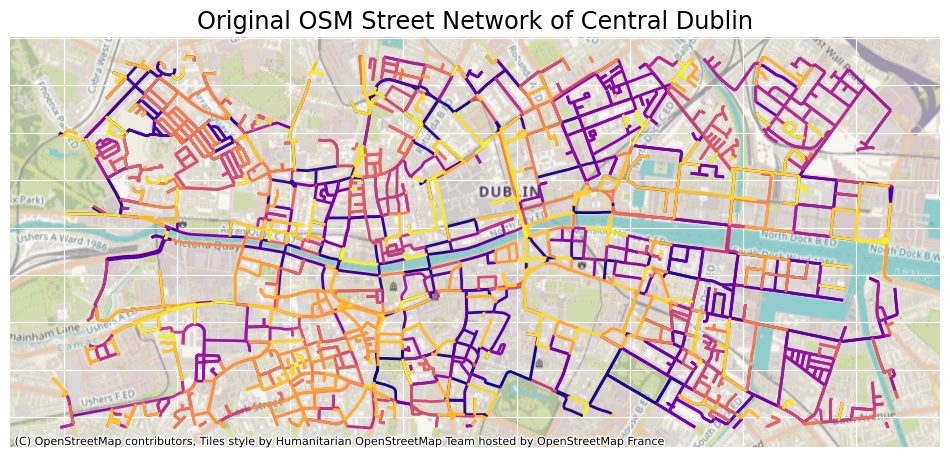

In [46]:
def filter_gdf_by_bbox(gdf, bbox):
    ### filters a GeoDataFrame by a specified bounding box
    minx, miny, maxx, maxy = bbox
    bbox_polygon = box(minx, miny, maxx, maxy)
    filtered_gdf = gdf[gdf.geometry.within(bbox_polygon)]
    return filtered_gdf


def plot_by_bbox(gdf, title, save = False):
    ## plot
    matplotlib.rcParams['font.size'] = 12.0

    fig, ax = plt.subplots(figsize=(12, 10))
    gdf.plot(cmap='plasma', linewidth=2, ax=ax, legend=True)
    ax.set_title(title)
    ctx.add_basemap(ax, crs=gdf.crs)

    for spine in ax.spines.values():
        spine.set_visible(False)
        
    ax.tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)

    if save:
        plt.savefig(f'{title}.pdf', dpi=300, format='pdf', bbox_inches='tight')

    plt.show()

## apply
bbox = (-6.301045, 53.336895, -6.226330, 53.356571)
filtered_gdf = filter_gdf_by_bbox(edges, bbox)

plot_by_bbox(filtered_gdf, 'Original OSM Street Network of Central Dublin', save = False)

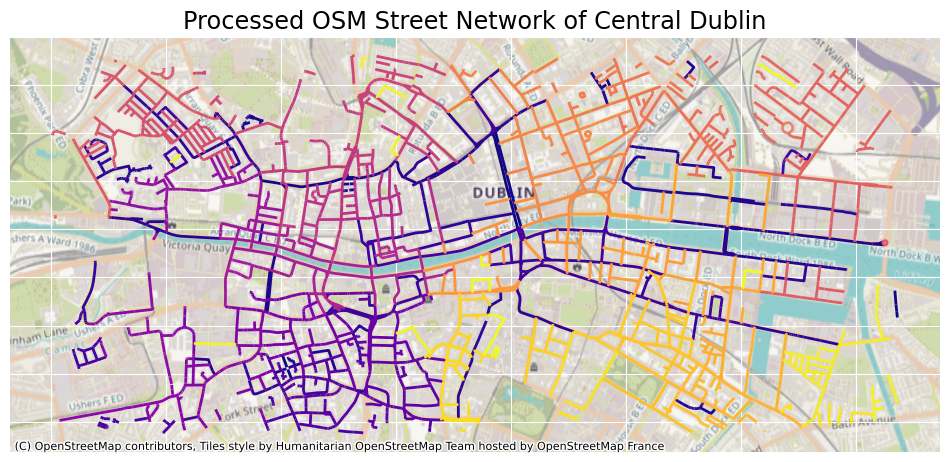

In [ ]:
plot_by_bbox(filter_gdf_by_bbox(final_edges, bbox), 
             'Processed OSM Street Network of Central Dublin', 
             save = False) ## neighbours/road blocks

In [52]:
copy_final_edges = final_edges.copy()
# convert to columns contained lists to datatype supported by parquet
for col in ['min_lanes', 'max_lanes', 'oneway', 'name', 'highway', 'max_maxspeed', 'min_maxspeed', 'standardized_name', 'osmid', 'tunnel', 'bridge']:
    copy_final_edges[col] = copy_final_edges[col].astype(str)
    
copy_final_edges.drop(columns=['osmid'], inplace=True)
copy_final_edges.explore('standardized_name', legend=False)

---

## Hamburg, Germany

In [28]:
## CRS used for Hamburg
crs_latlon = 'EPSG:4326'
crs_metric_hamburg = 'EPSG:10285'

In [9]:
# --------------------------------------------------------
#                        Load data 
# --------------------------------------------------------

place_name = 'Hamburg, Germany'
edges = load_roads_from_placename(place_name = place_name,  network_type='drive', simplify=True)
correct_datatypes(edges, ['osmid', 'oneway', 'lanes', 'name', 'highway', 'maxspeed', 'tunnel', 'bridge', 'width', 'junction', 'est_width'])
process_list_values(edges)


# --------------------------------------------------------
#                   Process Roundabouts
# --------------------------------------------------------

identified_junctions, edges = extract_roundabouts(edges)
roundabout_gdf = continous_roundabout(identified_junctions)
edges = augment_roundabouts(roundabout_gdf, identified_junctions, edges)


In [7]:
edges.name.explode().unique().tolist()

[nan,
 'Billhorner Brückenstraße',
 'Ludwig-Erhard-Straße',
 'Millerntordamm',
 'Millerntorplatz',
 'Budapester Straße',
 'Simon-von-Utrecht-Straße',
 'Eulenstraße',
 'Große Brunnenstraße',
 'Müggenburger Straße',
 'Peutestraße',
 'Georgswerder Bogen',
 'Harburger Chaussee',
 'Georg-Wilhelm-Straße',
 'Hafenrandstraße',
 'Reiherstieg-Hauptdeich',
 'Fährstraße',
 'Neuhöfer Straße',
 'Hohe-Schaar-Straße',
 'Auf der Hohen Schaar',
 'Stader Straße',
 'Großer Schippsee',
 'Buxtehuder Straße',
 'Neuländer Straße',
 'Schlachthofstraße',
 'Hannoversche Straße',
 'Kornweide',
 'Eversween',
 'Hohenzollernring',
 'Bleickenallee',
 'Harmsenstraße',
 'Behringstraße',
 'Ebertallee',
 'Osdorfer Weg',
 'Urnenfeld',
 'Osdorfer Landstraße',
 'Rugenfeld',
 'Sülldorfer Landstraße',
 'Schenefelder Landstraße',
 'Bergedorfer Straße',
 'Moorfleeter Straße',
 'Billbrookdeich',
 'Gelbe Brücke',
 'Bockhorster Weg',
 'Heidhorst',
 'Auf dem Langstücken',
 'Sander Damm',
 'Schulredder',
 'Am Langberg',
 'Langbergri

In [10]:
# --------------------------------------------------------
#           Build Continuous Road Representations
# --------------------------------------------------------

process_road_names(edges,
                    directions = ['obere', 'untere'],
                    abbreviations = {
                                'st': 'straße',
                                'rd': 'straße',
                                'al': 'allee',
                                'blv': 'boulevard'
                                },
                    words_to_rm = ['straße', 'strasse', 'st', 'rd',
                                   'al', 'allee', 'platz', 'blv', 
                                   'boulevard', 'weg'])

final_edges = merge_segments(edges, 
                             crs_metric = crs_metric_hamburg, 
                             crs_latlon = crs_latlon, 
                             verbose = True)


Unique sets: 761
Total occurrences: 1404
 ----------- RESULT PROCESSING LIST NAMES: ----------- 
Reduced from 761 to 734 geometries.
 ----------- RESULT PROCESSING STRING NAMES: ----------- 
Original number of segments (with unique name - as string): 49680
Final number of MultiLineStrings (geometries blocks) obtained: 7716
Reduction in number of geometries after recursion: from 8450 to 7287
Overall reduction: from 52303 in the original dataset, to 7287.


Check absence duplicates & overlaps:

In [ ]:
find_duplicate_or_overlapping_segments(final_edges) ## this check takes ~ 6 mins

[]

Missing values:

In [11]:
## number missing value per column
final_edges.isna().sum()

geometry                0
osmid                   0
min_lanes            5473
max_lanes            5473
min_maxspeed         1206
max_maxspeed         1206
oneway                  0
name                    0
highway               394
tunnel                  0
bridge                  0
standardized_name       0
ID_geom               305
length                  0
dtype: int64

In [12]:
## percentage missing value per column
final_edges.isna().mean() * 100

geometry              0.000000
osmid                 0.000000
min_lanes            75.106354
max_lanes            75.106354
min_maxspeed         16.550021
max_maxspeed         16.550021
oneway                0.000000
name                  0.000000
highway               5.406889
tunnel                0.000000
bridge                0.000000
standardized_name     0.000000
ID_geom               4.185536
length                0.000000
dtype: float64

Road length:

In [10]:
final_edges['length'].describe() # in meters

count     7287.000000
mean       569.221772
std        916.577005
min          6.144504
25%        178.353025
50%        313.594999
75%        590.467432
max      17594.183942
Name: length, dtype: float64

In [13]:
final_edges[final_edges['length'] <= final_edges['length'].mean() + 2*final_edges['length'].std()]['length'].describe()

count    7046.000000
mean      440.117246
std       404.875682
min         6.144504
25%       174.797816
50%       301.957055
75%       550.022180
max      2399.882166
Name: length, dtype: float64

Possible examples of segments reduction:

In [37]:
def original_vs_processed_plot(original_gdf, processed_gdf, road_name, figsize=(5, 5), crs_latlon = 'EPSG:4326'):

    ORIGINAL_VERSION = original_gdf[original_gdf['name'].apply(lambda x: road_name in x if isinstance(x, list) else x == road_name)]
    PROCESSED_VERSION = processed_gdf[processed_gdf['name'].apply(lambda x: road_name in x if isinstance(x, list) else x == road_name)]

    print(f"{road_name}: from {len(ORIGINAL_VERSION)} segments to {len(PROCESSED_VERSION)}.")

    matplotlib.rcParams['font.size'] = 12.0
    fig, axs = plt.subplots(1, 2, figsize=figsize)

    ## ORIGINAL PLOT
    ORIGINAL_VERSION.plot(cmap='plasma', linewidth=4, ax=axs[0], legend=False)
    ctx.add_basemap(axs[0], crs=crs_latlon)
    axs[0].set_title("Original Data", size=15)
    axs[0].tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)

    ## PROCESSED PLOT
    PROCESSED_VERSION.plot(cmap='plasma', linewidth=4, ax=axs[1], legend=False)
    ctx.add_basemap(axs[1], crs=crs_latlon)
    axs[1].set_title("Processed Data", size=15)
    axs[1].tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)

    ## remove plots border
    for spine in axs[0].spines.values():
        spine.set_visible(False)
    for spine in axs[1].spines.values():
        spine.set_visible(False)
    
    plt.show()

Kieler Straße: from 105 segments to 1.


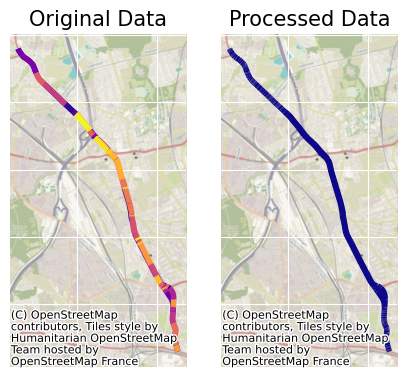

In [ ]:
original_vs_processed_plot(edges, final_edges, road_name = 'Kieler Straße', crs_latlon = 'EPSG:4326')

Elbchaussee: from 80 segments to 1.


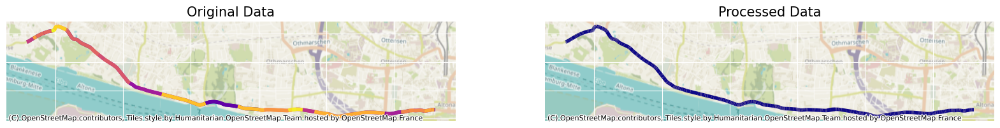

In [ ]:
original_vs_processed_plot(edges, final_edges, road_name = 'Elbchaussee', crs_latlon = 'EPSG:4326', figsize=(20, 20))

Überseeallee: from 11 segments to 2.


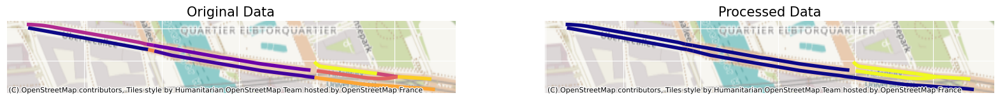

In [ ]:
original_vs_processed_plot(edges, final_edges, road_name = 'Überseeallee', crs_latlon = 'EPSG:4326', figsize=(20, 20))

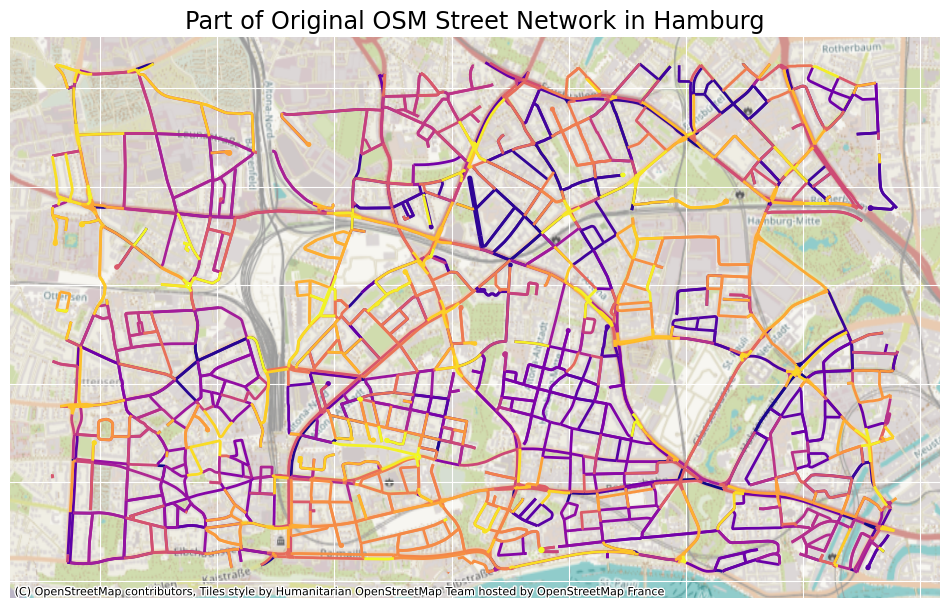

In [ ]:
# bbox_h = (9.957073,53.542707,10.024366,53.564042)
bbox_h = (9.915857,53.545421,9.988144,53.571332)

plot_by_bbox(filter_gdf_by_bbox(edges, bbox_h), 
             'Part of Original OSM Street Network in Hamburg', 
             save = False)

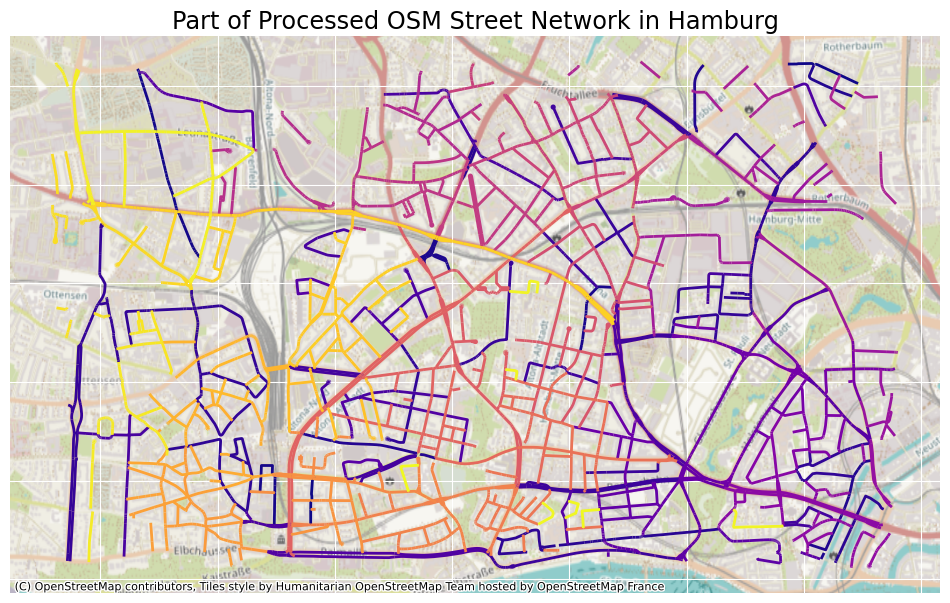

In [80]:
plot_by_bbox(filter_gdf_by_bbox(final_edges, bbox_h), 
             'Part of Processed OSM Street Network in Hamburg', 
             save = False)

Visualize:

In [9]:
copy_final_edges = final_edges.copy()
# convert to columns contained lists to datatype supported by parquet
for col in ['min_lanes', 'max_lanes', 'oneway', 'name', 'highway', 'max_maxspeed', 'min_maxspeed', 'standardized_name', 'osmid', 'tunnel', 'bridge']:
    copy_final_edges[col] = copy_final_edges[col].astype(str)
    
copy_final_edges.drop(columns=['osmid'], inplace=True)
copy_final_edges.explore('standardized_name', legend=False)

## Bristol, UK

In [2]:
## CRS used for Bristol, UK
crs_latlon = 'EPSG:4326'
crs_metric = 'EPSG:27700'

In [9]:
# --------------------------------------------------------
#                        Load data 
# --------------------------------------------------------

# get city road network as gdf
place_name = 'Bristol, United Kingdom'
edges = load_roads_from_placename(place_name = place_name, network_type='drive', simplify=True)
# check datatypes
correct_datatypes(edges, ['osmid', 'oneway', 'lanes', 'name', 'highway', 'maxspeed', 'tunnel', 'bridge', 'width', 'junction', 'est_width'])
# process attributes for meaningful aggregation

In [11]:
edges.tunnel.unique()

array([nan, 'yes', 'avalanche_protector', 'building_passage'],
      dtype=object)

In [12]:
edges.maxspeed.explode().unique()

array(['20 mph', nan, '30 mph', '40 mph', '70 mph', '15 mph', '60 mph',
       '5 mph', '10 mph', '50 mph', '3 mph'], dtype=object)

In [13]:
## process attributes
process_list_values(edges, 
                    tunnel_true_values = ['yes', 'building_passage', 'avalanche_protector'])

In [14]:
# --------------------------------------------------------
#                   Process Roundabouts
# --------------------------------------------------------

# extract roundabout segments
identified_junctions, edges = extract_roundabouts(edges)
# get junctions building geometries and compose the roundabouts
roundabout_gdf = continous_roundabout(identified_junctions)
# augment roundabout with other information from OSM (e.g., name, maxspeed, etc.) linked to the identified junction segments
# and augment overall edges dataset
edges = augment_roundabouts(roundabout_gdf, identified_junctions, edges)


# --------------------------------------------------------
#           Build Continuous Road Representations
# --------------------------------------------------------

process_road_names(edges)
final_edges = merge_segments(edges, crs_metric = crs_metric, crs_latlon = crs_latlon, verbose = True)

Unique sets: 256
Total occurrences: 481
 ----------- RESULT PROCESSING LIST NAMES: ----------- 
Reduced from 256 to 248 geometries.
 ----------- RESULT PROCESSING STRING NAMES: ----------- 
Original number of segments (with unique name - as string): 26493
Final number of MultiLineStrings (geometries blocks) obtained: 4580
Reduction in number of geometries after recursion: from 4828 to 4461
Overall reduction: from 27669 in the original dataset, to 4461.


Missing values:

In [19]:
## number missing value per column
final_edges.isna().sum()

geometry                0
osmid                   0
min_lanes            4082
max_lanes            4082
min_maxspeed         1580
max_maxspeed         1580
oneway                  0
name                    0
highway               388
tunnel                  0
bridge                  0
standardized_name       0
ID_geom               108
length                  0
dtype: int64

In [20]:
## percentage missing value per column
final_edges.isna().mean() * 100

geometry              0.000000
osmid                 0.000000
min_lanes            91.504147
max_lanes            91.504147
min_maxspeed         35.418068
max_maxspeed         35.418068
oneway                0.000000
name                  0.000000
highway               8.697601
tunnel                0.000000
bridge                0.000000
standardized_name     0.000000
ID_geom               2.420982
length                0.000000
dtype: float64

Road length:

In [ ]:
final_edges['length'].describe() # in meters

count     4461.000000
mean       262.260660
std        385.050740
min          6.514824
25%         86.341616
50%        155.621566
75%        288.194343
max      11749.008405
Name: length, dtype: float64

In [22]:
final_edges[final_edges['length'] <= final_edges['length'].mean() + 2*final_edges['length'].std()]['length'].describe()

count    4316.000000
mean      212.205535
std       184.322483
min         6.514824
25%        84.617427
50%       150.277195
75%       270.704453
max      1029.764293
Name: length, dtype: float64

Examples of reduction:

Fishponds Road: from 133 segments to 1.


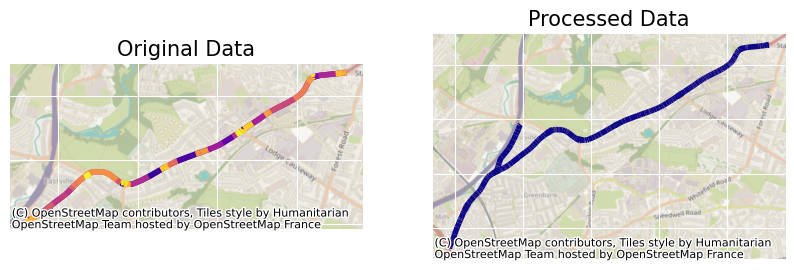

In [41]:
original_vs_processed_plot(edges, final_edges, road_name = 'Fishponds Road', figsize=(10, 10))

Portway: from 69 segments to 3.


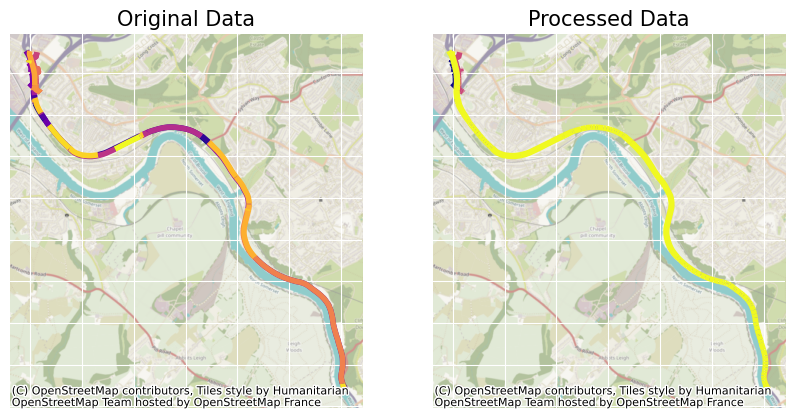

In [42]:
original_vs_processed_plot(edges, final_edges, road_name = 'Portway', figsize=(10, 10))

Bath Road: from 82 segments to 2.


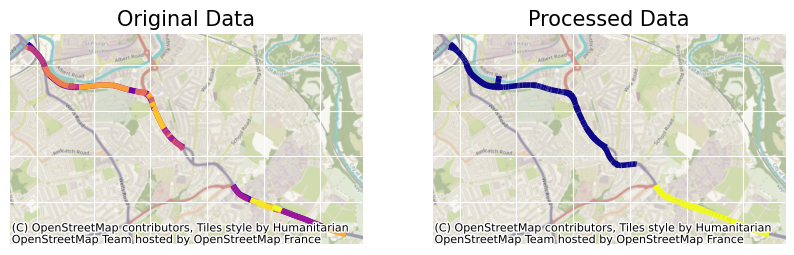

In [43]:
original_vs_processed_plot(edges, final_edges, road_name = 'Bath Road', figsize=(10, 10))

Saint John's Lane: from 72 segments to 2.


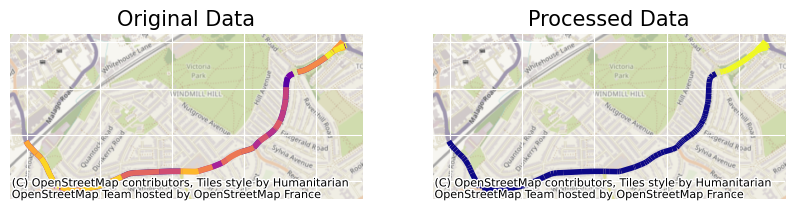

In [44]:
original_vs_processed_plot(edges, final_edges, road_name = "Saint John's Lane", figsize=(10, 10))

North Street: from 76 segments to 2.


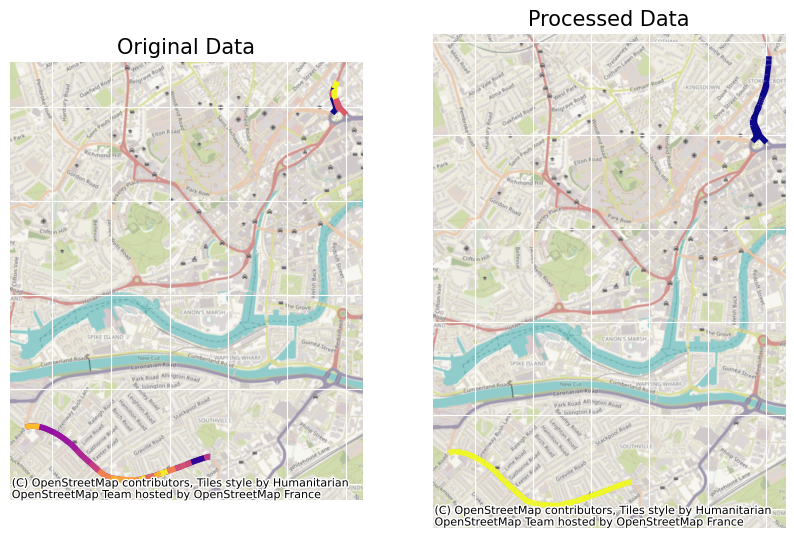

In [45]:
original_vs_processed_plot(edges, final_edges, road_name = 'North Street', figsize=(10, 10))

Southmead Road: from 83 segments to 2.


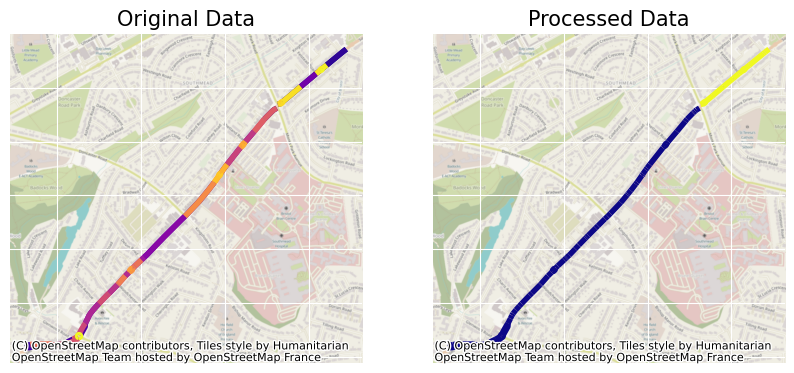

In [46]:
original_vs_processed_plot(edges, final_edges, road_name = 'Southmead Road', figsize=(10, 10))

Grosvenor Road: from 14 segments to 1.


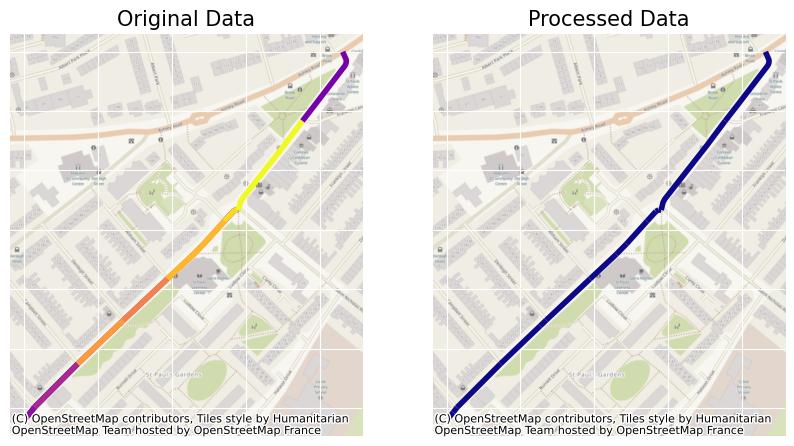

In [39]:
original_vs_processed_plot(edges, final_edges, road_name = 'Grosvenor Road', figsize=(10, 10))

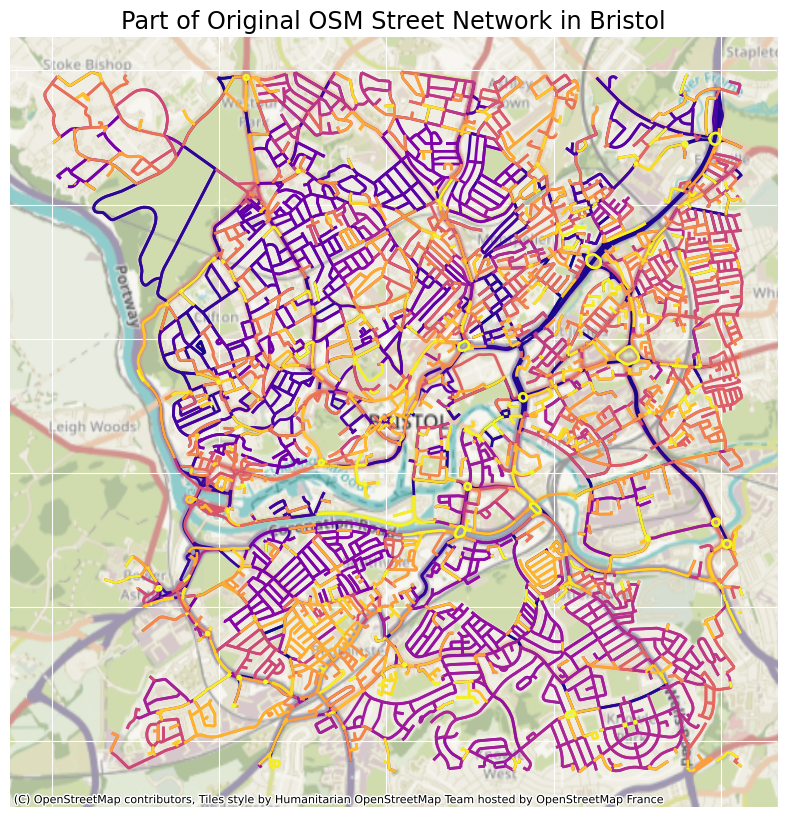

In [ ]:
## SECTION OF ROAD NETWORK:
## BEFORE
bbox_bristol = (-2.641135,51.427694,-2.557425,51.479901)

plot_by_bbox(filter_gdf_by_bbox(edges, bbox_bristol), 
             'Part of Original OSM Street Network in Bristol', 
             save = False)

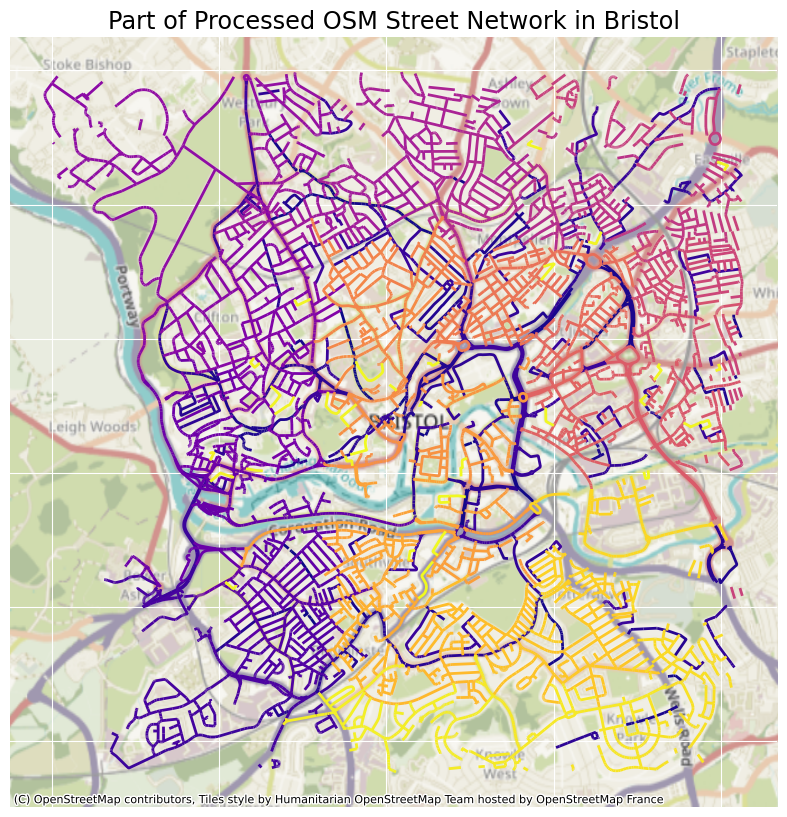

In [49]:
## AFTER
plot_by_bbox(filter_gdf_by_bbox(final_edges, bbox_bristol), 
             'Part of Processed OSM Street Network in Bristol', 
             save = False)

Visualize

In [18]:
copy_final_edges = final_edges.copy()
# convert to columns contained lists to datatype supported by parquet
for col in ['min_lanes', 'max_lanes', 'oneway', 'name', 'highway', 'max_maxspeed', 'min_maxspeed', 'standardized_name', 'osmid', 'tunnel', 'bridge']:
    copy_final_edges[col] = copy_final_edges[col].astype(str)
    
copy_final_edges.drop(columns=['osmid'], inplace=True)
copy_final_edges.explore('standardized_name', legend=False)